# Data exploration of House Price Predictions


The data is downloaded from Kaggle and contains data about houses and around ~80 variables. The goal is to use these explanatory variables to predict the House Prices. Here, we are dealing with a regression problem. As we want to conduct a classification, as well, we will also divide the SalePrice in three categories, namely "low", "middle" and "upper class". We will then attempt to predict these 3 classes. 

https://www.kaggle.com/c/house-prices-advanced-regression-techniques

This notebook is to explore the data, to understand the basic relationships between the variables and to get a feeling about which variables might be good predictors for the House prices. There will be a separate notebook containing statistical and machine learning models for the predictions.

Author: Julia Hammerer, Vanessa Mai
Last Changes: 18.11.2018

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Data-exploration-of-House-Price-Predictions" data-toc-modified-id="Data-exploration-of-House-Price-Predictions-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Data exploration of House Price Predictions</a></span><ul class="toc-item"><li><span><a href="#Data-Profile" data-toc-modified-id="Data-Profile-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Data Profile</a></span></li><li><span><a href="#Missing-values" data-toc-modified-id="Missing-values-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Missing values</a></span></li><li><span><a href="#Sanity-checks" data-toc-modified-id="Sanity-checks-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Sanity checks</a></span></li><li><span><a href="#Cleanse-data" data-toc-modified-id="Cleanse-data-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Cleanse data</a></span></li><li><span><a href="#Explorations" data-toc-modified-id="Explorations-1.5"><span class="toc-item-num">1.5&nbsp;&nbsp;</span>Explorations</a></span><ul class="toc-item"><li><span><a href="#Correlation-Analysis-for-numeric-features" data-toc-modified-id="Correlation-Analysis-for-numeric-features-1.5.1"><span class="toc-item-num">1.5.1&nbsp;&nbsp;</span>Correlation Analysis for numeric features</a></span></li><li><span><a href="#Categorical-Features" data-toc-modified-id="Categorical-Features-1.5.2"><span class="toc-item-num">1.5.2&nbsp;&nbsp;</span>Categorical Features</a></span></li></ul></li><li><span><a href="#Explorations-based-on-self-defined-categories" data-toc-modified-id="Explorations-based-on-self-defined-categories-1.6"><span class="toc-item-num">1.6&nbsp;&nbsp;</span>Explorations based on self-defined categories</a></span></li></ul></li></ul></div>

In [1]:
import sys
sys.path.insert(0, '../helper/')

In [2]:
# load packages
%matplotlib inline
import numpy as np
import pandas as pd
import seaborn as sns
import pandas_profiling
import missingno as msno
import matplotlib.pyplot as plt
import plotly.graph_objs as go
import warnings
import math

from pandas.tools.plotting import table
from plotly.offline import init_notebook_mode
from plotly.offline import iplot
from plotly.offline import plot
from scipy.stats import mannwhitneyu
from statsmodels.distributions.empirical_distribution import ECDF
from scipy import stats
from scipy.stats import pearsonr
from scipy.stats import norm

from helper import na_ratio_table
from helper import corr_heatmap
from helper import corr_matrix_1


C:\Users\maiv2\AppData\Local\Continuum\anaconda3\lib\site-packages\pandas_profiling\plot.py:15: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

The backend was *originally* set to 'module://ipykernel.pylab.backend_inline' by the following code:
  File "C:\Users\maiv2\AppData\Local\Continuum\anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\Users\maiv2\AppData\Local\Continuum\anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\maiv2\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel\__main__.py", line 3, in <module>
    app.launch_new_instance()
  File "C:\Users\maiv2\AppData\Local\Continuum\anaconda3\lib\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\maiv

In [3]:
warnings.filterwarnings('ignore')

In [4]:
#load data
# we have two files, since this is a part of a kaggle competition,
# only the training-set contains the target variable
# we will use that for the whole analysis

df=pd.read_csv("../data/house_prices_train.csv")

In [5]:
print("Number of records and variables: ",df.shape)

Number of records and variables:  (1460, 81)


## Data Profile

In [6]:
# for a first overview, we apply the pandas-profile report
# it provides simple histograms, distributions, missingness 
# and correlations for all variables

pandas_profiling.ProfileReport(df)

Number of variables,81
Number of observations,1460
Total Missing (%),5.9%
Total size in memory,924.0 KiB
Average record size in memory,648.1 B
Numeric,38
Categorical,43
Boolean,0
Date,0
Text (Unique),0
Rejected,0


A description of all data fields can be found on the Kaggle site: https://www.kaggle.com/c/house-prices-advanced-regression-techniques/data. Most of them are self-explanatory though.

Around half the variables are categorical and the other half are numerical. For the categorical variables there will be need to use hot-one-encoding for incorporating them into the prediction models.

We can already spot some correlations that look promising. Some of them
also are also expected and won't give us further insights. We are particularly
interested in correlations with our target variable
- OverallQual - SalePrice
- GrLivArea - SalePrice
- FullBath - SalePrice
- GarageYrBlt - YearRemodAdd
- LotFrontage - lotArea
- TotRmsAbvGrd - GrLivArea
- BsmtUnfSF - BsmtFinSF1: negative correlation

Also, we can detect variables that probably won't be of much use
e.g.
- Street: only two values, of which one is extremly low.
- Utilities: Almost constant with two values, of which the other one has only one record

In [7]:
df.select_dtypes(include=['object']).head()

,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,...,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
0,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
1,RL,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
2,RL,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
3,RL,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,...,Detchd,Unf,TA,TA,Y,NaN,NaN,NaN,WD,Abnorml
4,RL,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,...,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal


## Missing values
Let's check the missingness in more detail

In [8]:
display(na_ratio_table(df)[na_ratio_table(df)["NA_COUNT"]>0])
display(na_ratio_table(df)[na_ratio_table(df)["NA_COUNT"]>0].shape)


,NA_COUNT,NA_RATIO_PERC
LotFrontage,259,17.739726
Alley,1369,93.767123
MasVnrType,8,0.547945
MasVnrArea,8,0.547945
BsmtQual,37,2.534247
BsmtCond,37,2.534247
BsmtExposure,38,2.602740
BsmtFinType1,37,2.534247
BsmtFinType2,38,2.602740
Electrical,1,0.068493


(19, 2)

We have 19 variables that contain missing values. Most of them mean that the feature is simply not available for that property. However for a few, this can indicate a data quality issue:
- Electrical: the type is not stated, it is improbable that there is no electrical system at all. 
- LotFrontage: a building should always have a lotfrontage

As for "Electrical" only one record is missing, we can simply filter this out, or even ignore this. For the LotFrontage we can apply some imputation-techniques if necessary.

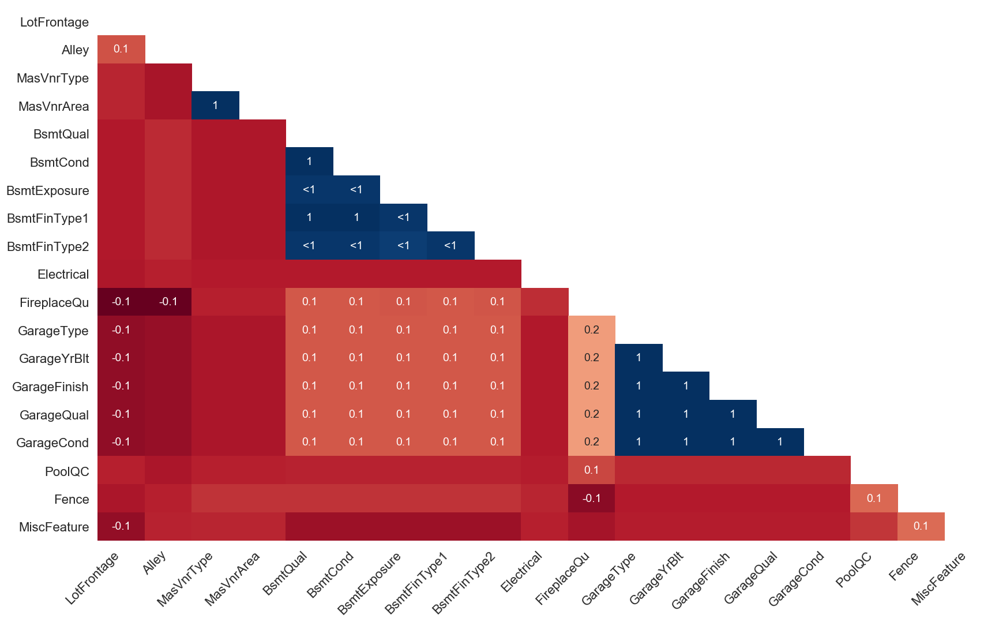

In [9]:
# we test if the data is randomly missing, or if there are some patterns in the missingness
# this helps us indicate whether there are data quality issues or if the missingness is part of the data
msno.heatmap(df)

As expected, we can see that some of the variables are always missing together, which makes absolutely sense. 
Example: All Garage related variables are always missing together. Reason: no garage -> no values for any garage features.
The other group of variables missing together is related to the basement. Because of these correlations, we might run into some multicollinearity issues in the modelling part later on.  "Multicollinearity is a state of very high intercorrelations or inter-associations among the independent variables. It is therefore a type of disturbance in the data, and if present in the data the statistical inferences made about the data may not be reliable." (https://www.statisticssolutions.com/multicollinearity/, Accesed on: 22.11.2018) <br>


## Sanity checks
We're going to check if there are some inconsistencies in the data or duplicates, etc. (Quality assessment)

In [10]:
# any duplicates?
df[df.duplicated(keep=False)]


,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice


In [11]:
# any built year before sold year?
df.query('YearBuilt > YrSold')


,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice


## Cleanse data

In [12]:
# remove useless columns
df=df.drop(columns=["Id", "Street", "Utilities"])

In [13]:
# remove the missing record for Electrical
df=df[df["Electrical"].isna()==False]

## Explorations

In [14]:
df.describe()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1459.000000,1200.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1451.00000,1459.000000,1459.000000,...,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000,1459.000000
mean,56.881426,70.047500,10517.363948,6.100069,5.575737,1971.244003,1984.850583,103.75672,443.943797,46.581220,...,94.240576,46.692255,21.969157,3.411926,15.071282,2.760795,43.518849,6.322824,2007.815627,180930.394791
std,42.310746,24.294727,9984.666267,1.383171,1.113079,30.199555,20.644343,181.10815,456.106417,161.369977,...,125.381679,66.267472,61.137400,29.327247,55.775138,40.191018,496.291826,2.704331,1.328542,79468.964025
min,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.00000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,20.000000,59.000000,7549.000000,5.000000,5.000000,1954.000000,1967.000000,0.00000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129950.000000
50%,50.000000,69.000000,9477.000000,6.000000,5.000000,1973.000000,1994.000000,0.00000,384.000000,0.000000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,70.000000,80.000000,11603.000000,7.000000,6.000000,2000.000000,2004.000000,166.00000,712.500000,0.000000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.00000,5644.000000,1474.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


Let's once again check the distribution of the SalePrice

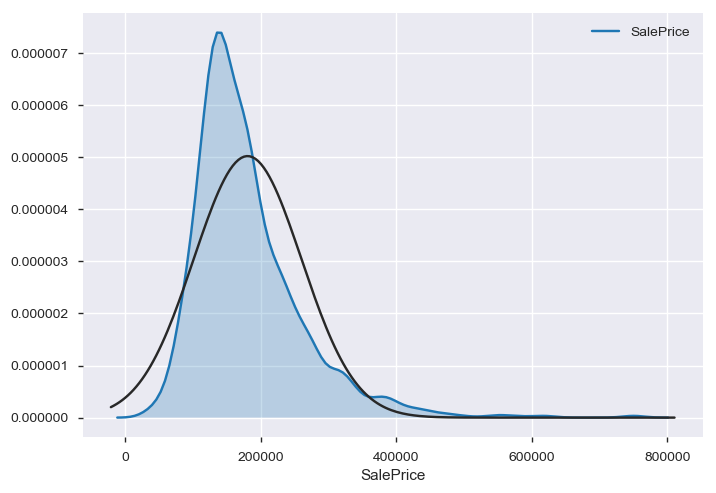

In [15]:
sns.distplot(df["SalePrice"], hist=False, label="SalePrice", fit=norm,  kde_kws={"shade": True})

The distribution is slightly skewed. 

((array([-3.30494753, -3.04772643, -2.90468264, ...,  2.90468264,
          3.04772643,  3.30494753]),
  array([ 34900,  35311,  37900, ..., 625000, 745000, 755000], dtype=int64)),
 (74187.860388132, 180930.39479095273, 0.9320032714937404))

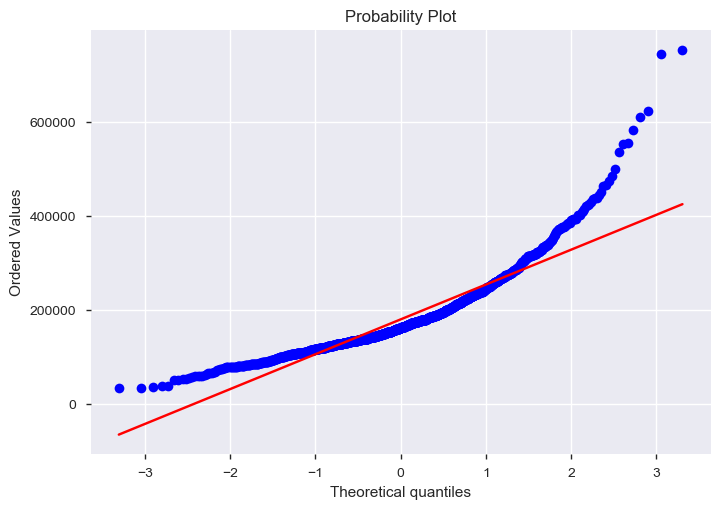

In [16]:
stats.probplot(df['SalePrice'], plot=plt)

SalePrice does not have a normal distribution.

### Correlation Analysis for numeric features

In [17]:
# we check for further correlations using different plots
NUM_FEATURES =df.select_dtypes(include=[np.number]).columns.tolist()

df_num=df[NUM_FEATURES]

df_corr=df_num.corr()

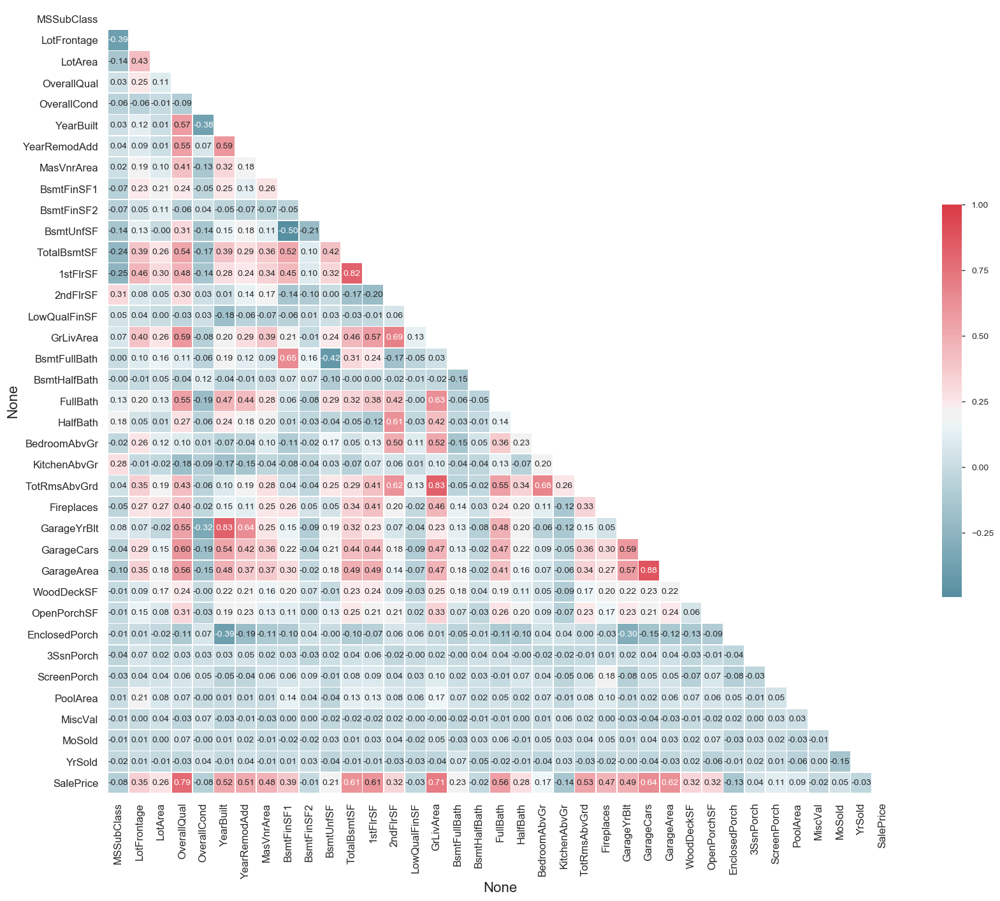

In [18]:
corr_heatmap(df_corr, figsize=(20, 16))

In [19]:
corr_matrix_1(df_corr)

This visualization is not suitable due to the great amount of variables. Let's filter out the ones with the highest correlations and visualize those.

In [20]:
df_corr=df_corr.abs()

df_corr=(df_corr.where(~np.tril(np.ones(df_corr.shape)).astype(np.bool)))

df_high_corr=(df_corr[df_corr>0.75].dropna(how="all", axis=0).dropna(how="all", axis=1))

df_high_corr_vars=np.unique(np.concatenate((df_high_corr.columns.values, df_high_corr.index.values)))

df_high_corr = df[df_high_corr_vars]

df_high_corr.shape

(1459, 10)

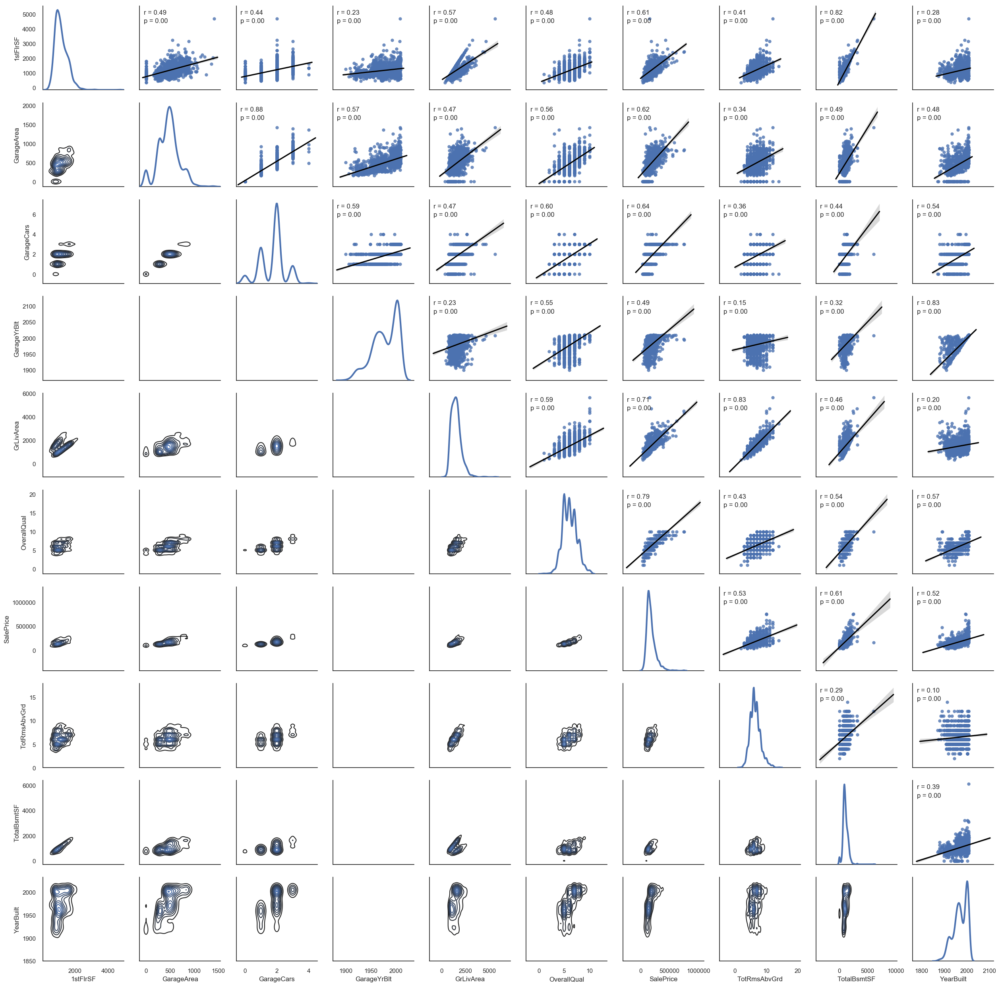

In [21]:
corr_matrix_1(df_high_corr)

In [22]:
df_corr.iloc[:,-1].sort_values(ascending=False)[:10]

OverallQual     0.791069
GrLivArea       0.708618
GarageCars      0.640473
GarageArea      0.623423
TotalBsmtSF     0.613905
1stFlrSF        0.605968
FullBath        0.560881
TotRmsAbvGrd    0.533779
YearBuilt       0.523273
YearRemodAdd    0.507430
Name: SalePrice, dtype: float64

The variables which seem to have a high correlation with the target variable are also amongst the ones with the highest correlations in general.
Let's also have a look at some of the categorical variables. 

### Categorical Features

In [23]:
CAT_FEATURES =df.select_dtypes(include="object").columns.tolist()

In [24]:
plt.figure(figsize=(40,400))

for i, a in enumerate(CAT_FEATURES):
#     plt.figure(figsize=(5,2))
    plt.subplot(math.ceil(len(CAT_FEATURES)),2,((i+1)*2-1))
    sns.boxplot(x="SalePrice", y=a, data=df)
    plt.ylabel(a, fontsize=40)
    plt.tick_params(axis='y', which='major', labelsize=30)

    plt.subplot(math.ceil(len(CAT_FEATURES)),2,((i+1)*2))
    for b in df[a].unique():
        sns.distplot(df[df[a]==b]["SalePrice"], hist=False, label=a,  kde_kws={"shade": True})
#     plt.ylabel(a, fontsize=40)

#     plt.tight_layout()
# sns.distplot(tsh_sta_pcu.query('Label_trunc == "PCU1"')['Wdf'], hist=False, label='PCU1', kde_kws={"shade": True})
# sns.distplot(tsh_sta_pcu.query('Label_trunc == "PCU2"')['Wdf'], hist=False, label='PCU2', kde_kws={"shade": True});

This gives us a feeling of which attributes might be more important and can help us predict the SalePrice.
For these attributes for example the SalePrice is different based on the value:
* Alley
* Neighborhood
* ExterQual
* ExterCond
* KitchenQual
* PoolQual

For BsmtFinType2 e.g. the SalePrice cannot be differentiated much. Hence, this attribute might have less predictive power compared to some of the other attriutes.

The EDA here already shows us potential to predict the SalePrice. Definitively, there are some relationship towards the SalePrice. Next step is to built models to predict the SalePrice and investigate the significance of differences in the attributes.

## Explorations based on self-defined categories
As mentioned in the beginning, we will also divide the SalePrice in three categories, namely "low", "middle" and "upper class". Thus, we also want to see how these three can be separated and if there is some obvious differences. 

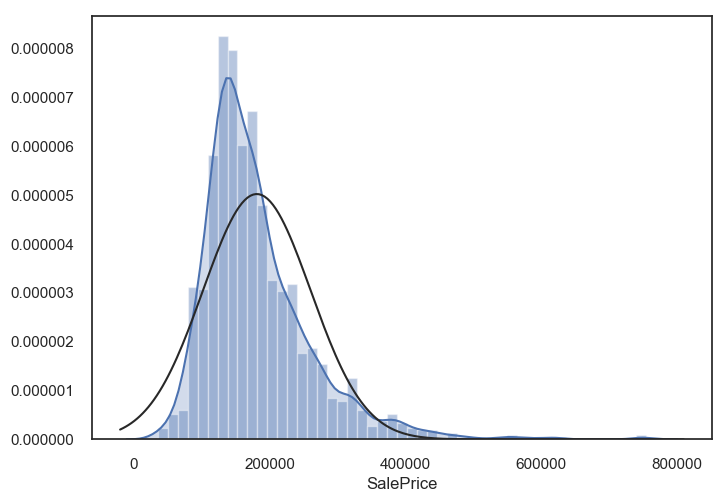

In [25]:
sns.distplot(df["SalePrice"], hist=True, label="SalePrice", fit=norm,  kde_kws={"shade": True})

In [26]:
df["SalePrice"].describe()

count      1459.000000
mean     180930.394791
std       79468.964025
min       34900.000000
25%      129950.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

In [27]:
df["SalePrice"].median()

163000.0

(array([148., 722., 373., 135.,  51.,  19.,   4.,   3.,   2.,   2.]),
 array([ 34900., 106910., 178920., 250930., 322940., 394950., 466960.,
        538970., 610980., 682990., 755000.]),
 <a list of 10 Patch objects>)

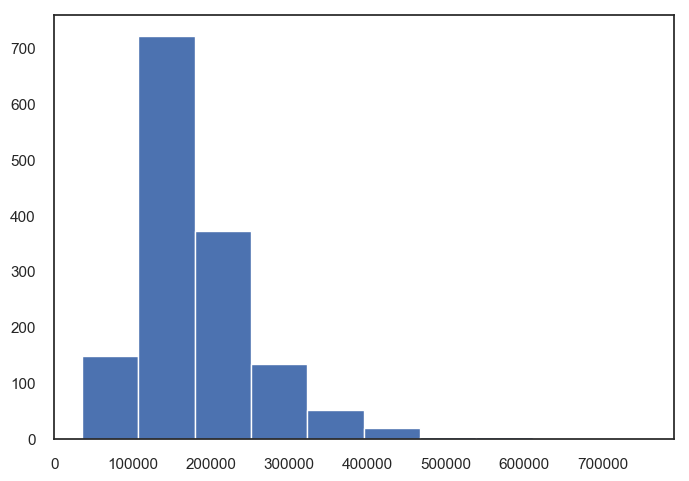

In [28]:
plt.hist(df.SalePrice, bins=10)

The range of the SalePrice is from 34,900 - 755,000. The middle class would be the most frequent one. We decided to use the following boundaries:
- low: 0-100,000
- middle: 100,001-400,000
- upper: from 400,001 onwards

In [29]:
# create new column
def price_class(row):
    if row["SalePrice"]<=120000:
        return "low"
    elif (row["SalePrice"]>120000)& (row["SalePrice"]<=250000):
        return "middle"
    else:
        return"upper"


df["Price_Class"]= df.apply(lambda row: price_class(row), axis=1)

In [30]:
plt.figure(figsize=(40,400))

for i, a in enumerate(NUM_FEATURES):
#     plt.figure(figsize=(5,2))
    plt.subplot(math.ceil(len(CAT_FEATURES)),2,((i+1)*2-1))
    sns.boxplot(y=a, x="Price_Class", data=df)
    plt.ylabel(a, fontsize=40)
    plt.tick_params(axis='y', which='major', labelsize=30)

    plt.subplot(math.ceil(len(CAT_FEATURES)),2,((i+1)*2))
    for b in df["Price_Class"].unique():
        sns.distplot(df[df["Price_Class"]==b][a], hist=False, label=b,  kde_kws={"shade": True})
#     plt.ylabel(a, fontsize=40)

#     plt.tight_layout()
# sns.distplot(tsh_sta_pcu.query('Label_trunc == "PCU1"')['Wdf'], hist=False, label='PCU1', kde_kws={"shade": True})
# sns.distplot(tsh_sta_pcu.query('Label_trunc == "PCU2"')['Wdf'], hist=False, label='PCU2', kde_kws={"shade": True});